<a href="https://colab.research.google.com/github/cjayjonathan/Covid-19-Impacts-Analysis/blob/main/Covid_19_Impacts_Analysis_using_Python.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

The global economy was unprepared for the first wave of the COVID-19 pandemic, resulting in a significant impact on various sectors. This includes an increase in cases, deaths, unemployment, and poverty, leading to a slowdown in economic activity. As part of this analysis, we will investigate the spread of COVID-19 cases and its effects on the economy.

To conduct this analysis, we will utilize a dataset downloaded from Kaggle, which includes the following information:

Country code
Country name
Date of the record
Human development index of all countries
Daily COVID-19 cases
Daily deaths attributed to COVID-19
Stringency index of the countries
Population of the countries
GDP per capita of the countries

In [ ]:
#  Importing the necessary Python libraries and the dataset:

import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import pygwalker as pyg

data = pd.read_csv("C:\\Users\\owner\\Downloads\\COVID_Data\\transformed_data.csv")
data2 = pd.read_csv("C:\\Users\\owner\\Downloads\\COVID_Data\\raw_data.csv")
print(data)
pyg.walk(data)

      CODE      COUNTRY        DATE    HDI        TC        TD       STI  \
0      AFG  Afghanistan  2019-12-31  0.498  0.000000  0.000000  0.000000   
1      AFG  Afghanistan  2020-01-01  0.498  0.000000  0.000000  0.000000   
2      AFG  Afghanistan  2020-01-02  0.498  0.000000  0.000000  0.000000   
3      AFG  Afghanistan  2020-01-03  0.498  0.000000  0.000000  0.000000   
4      AFG  Afghanistan  2020-01-04  0.498  0.000000  0.000000  0.000000   
...    ...          ...         ...    ...       ...       ...       ...   
50413  ZWE     Zimbabwe  2020-10-15  0.535  8.994048  5.442418  4.341855   
50414  ZWE     Zimbabwe  2020-10-16  0.535  8.996528  5.442418  4.341855   
50415  ZWE     Zimbabwe  2020-10-17  0.535  8.999496  5.442418  4.341855   
50416  ZWE     Zimbabwe  2020-10-18  0.535  9.000853  5.442418  4.341855   
50417  ZWE     Zimbabwe  2020-10-19  0.535  9.005405  5.442418  4.341855   

             POP    GDPCAP  
0      17.477233  7.497754  
1      17.477233  7.497754  


Data Preparation
The dataset we are working with consists of two files, one containing raw data and the other containing transformed data. To complete this task effectively, we need to utilize both datasets since they contain important information in different columns. Therefore, let's examine both datasets individually.

In [ ]:
print(data.head())
pyg.walk(data.head())

  CODE      COUNTRY        DATE    HDI   TC   TD  STI        POP    GDPCAP
0  AFG  Afghanistan  2019-12-31  0.498  0.0  0.0  0.0  17.477233  7.497754
1  AFG  Afghanistan  2020-01-01  0.498  0.0  0.0  0.0  17.477233  7.497754
2  AFG  Afghanistan  2020-01-02  0.498  0.0  0.0  0.0  17.477233  7.497754
3  AFG  Afghanistan  2020-01-03  0.498  0.0  0.0  0.0  17.477233  7.497754
4  AFG  Afghanistan  2020-01-04  0.498  0.0  0.0  0.0  17.477233  7.497754


In [ ]:
print(data2.head())
pyg.walk(data2.head())

  iso_code     location        date  total_cases  total_deaths  \
0      AFG  Afghanistan  2019-12-31          0.0           0.0   
1      AFG  Afghanistan  2020-01-01          0.0           0.0   
2      AFG  Afghanistan  2020-01-02          0.0           0.0   
3      AFG  Afghanistan  2020-01-03          0.0           0.0   
4      AFG  Afghanistan  2020-01-04          0.0           0.0   

   stringency_index  population  gdp_per_capita  human_development_index  \
0               0.0    38928341        1803.987                    0.498   
1               0.0    38928341        1803.987                    0.498   
2               0.0    38928341        1803.987                    0.498   
3               0.0    38928341        1803.987                    0.498   
4               0.0    38928341        1803.987                    0.498   

  Unnamed: 9 Unnamed: 10 Unnamed: 11  Unnamed: 12  Unnamed: 13  
0      #NUM!       #NUM!       #NUM!    17.477233  7.497754494  
1      #NUM!    

Upon examining both datasets, it became apparent that a new dataset would need to be created by merging the two. However, before proceeding with the creation of a new dataset, it is essential to determine the number of samples available for each country in the dataset.

In [ ]:
data["COUNTRY"].value_counts()


Afghanistan        294
Indonesia          294
Macedonia          294
Luxembourg         294
Lithuania          294
                  ... 
Tajikistan         172
Comoros            171
Lesotho            158
Hong Kong           51
Solomon Islands      4
Name: COUNTRY, Length: 210, dtype: int64

The dataset does not have an equal distribution of samples for each country. Let's examine the mode value:

In [ ]:
data["COUNTRY"].value_counts().mode()

0    294
Name: COUNTRY, dtype: int64

The mode value is 294, which we will use to divide the sum of all samples related to the human development index, GDP per capita, and population. Subsequently, we will create a new dataset by merging the relevant columns from both datasets.

In [ ]:
# Aggregating the data

code = data["CODE"].unique().tolist()
country = data["COUNTRY"].unique().tolist()
hdi = []
tc = []
td = []
sti = []
population = data["POP"].unique().tolist()
gdp = []

for i in country:
    hdi.append((data.loc[data["COUNTRY"] == i, "HDI"]).sum()/294)
    tc.append((data2.loc[data2["location"] == i, "total_cases"]).sum())
    td.append((data2.loc[data2["location"] == i, "total_deaths"]).sum())
    sti.append((data.loc[data["COUNTRY"] == i, "STI"]).sum()/294)
    population.append((data2.loc[data2["location"] == i, "population"]).sum()/294)

aggregated_data = pd.DataFrame(list(zip(code, country, hdi, tc, td, sti, population)), 
                               columns = ["Country Code", "Country", "HDI", 
                                          "Total Cases", "Total Deaths", 
                                          "Stringency Index", "Population"])
print(aggregated_data.head())
pyg.walk(aggregated_data.head())

  Country Code      Country       HDI  Total Cases  Total Deaths  \
0          AFG  Afghanistan  0.498000    5126433.0      165875.0   
1          ALB      Albania  0.600765    1071951.0       31056.0   
2          DZA      Algeria  0.754000    4893999.0      206429.0   
3          AND      Andorra  0.659551     223576.0        9850.0   
4          AGO       Angola  0.418952     304005.0       11820.0   

   Stringency Index  Population  
0          3.049673   17.477233  
1          3.005624   14.872537  
2          3.195168   17.596309  
3          2.677654   11.254996  
4          2.965560   17.307957  


I have excluded the GDP per capita column from the dataset as I did not find accurate figures for it. Therefore, it would be best to manually gather data on the GDP per capita of the countries. However, since this dataset includes many countries, it would be challenging to manually collect GDP per capita data for all of them. Thus, to create a subsample, I will choose the top 10 countries with the highest number of Covid-19 cases, which will be an ideal sample for studying the economic consequences of the pandemic. Therefore, I will sort the data by total Covid-19 cases to create this subsample.

In [ ]:
# Sorting Data According to Total Cases

data = aggregated_data.sort_values(by=["Total Cases"], ascending=False)
print(data.head())
pyg.walk(data.head())

    Country Code        Country      HDI  Total Cases  Total Deaths  \
200          USA  United States  0.92400  746014098.0    26477574.0   
27           BRA         Brazil  0.75900  425704517.0    14340567.0   
90           IND          India  0.64000  407771615.0     7247327.0   
157          RUS         Russia  0.81600  132888951.0     2131571.0   
150          PER           Peru  0.59949   74882695.0     3020038.0   

     Stringency Index  Population  
200          3.350949   19.617637  
27           3.136028   19.174732  
90           3.610552   21.045353  
157          3.380088   18.798668  
150          3.430126   17.311165  


# Top 10 Countries with Highest Covid Cases


In [ ]:
# Top 10 Countries with Highest Covid Cases

data = data.head(10)
print(data)
pyg.walk(data)

    Country Code         Country       HDI  Total Cases  Total Deaths  \
200          USA   United States  0.924000  746014098.0    26477574.0   
27           BRA          Brazil  0.759000  425704517.0    14340567.0   
90           IND           India  0.640000  407771615.0     7247327.0   
157          RUS          Russia  0.816000  132888951.0     2131571.0   
150          PER            Peru  0.599490   74882695.0     3020038.0   
125          MEX          Mexico  0.774000   74347548.0     7295850.0   
178          ESP           Spain  0.887969   73717676.0     5510624.0   
175          ZAF    South Africa  0.608653   63027659.0     1357682.0   
42           COL        Colombia  0.581847   60543682.0     1936134.0   
199          GBR  United Kingdom  0.922000   59475032.0     7249573.0   

     Stringency Index  Population  
200          3.350949   19.617637  
27           3.136028   19.174732  
90           3.610552   21.045353  
157          3.380088   18.798668  
150          3.4

Next, I will append two additional columns to this dataset, namely the GDP per capita before Covid-19 and the GDP per capita during Covid-19.
Note: The data about the GDP per capita is collected manually.

In [ ]:
data["GDP Before Covid"] = [65279.53, 8897.49, 2100.75, 
                            11497.65, 7027.61, 9946.03, 
                            29564.74, 6001.40, 6424.98, 42354.41]
data["GDP During Covid"] = [63543.58, 6796.84, 1900.71, 
                            10126.72, 6126.87, 8346.70, 
                            27057.16, 5090.72, 5332.77, 40284.64]
print(data)
pyg.walk(data)

    Country Code         Country       HDI  Total Cases  Total Deaths  \
200          USA   United States  0.924000  746014098.0    26477574.0   
27           BRA          Brazil  0.759000  425704517.0    14340567.0   
90           IND           India  0.640000  407771615.0     7247327.0   
157          RUS          Russia  0.816000  132888951.0     2131571.0   
150          PER            Peru  0.599490   74882695.0     3020038.0   
125          MEX          Mexico  0.774000   74347548.0     7295850.0   
178          ESP           Spain  0.887969   73717676.0     5510624.0   
175          ZAF    South Africa  0.608653   63027659.0     1357682.0   
42           COL        Colombia  0.581847   60543682.0     1936134.0   
199          GBR  United Kingdom  0.922000   59475032.0     7249573.0   

     Stringency Index  Population  GDP Before Covid  GDP During Covid  
200          3.350949   19.617637          65279.53          63543.58  
27           3.136028   19.174732           8897.49 

To begin with, let's analyze the spread of Covid-19 in the countries with the highest number of cases. Firstly, we will examine the countries that have recorded the highest number of Covid-19 cases.

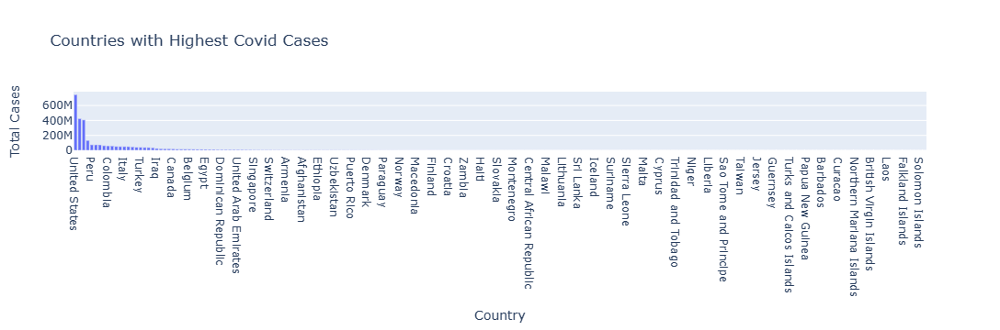

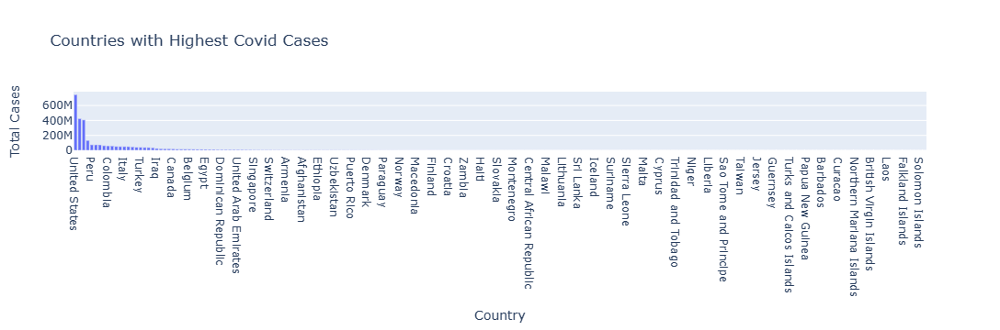

In [ ]:
figure = px.bar(data, y='Total Cases', x='Country',
            title="Countries with Highest Covid Cases")
figure.show()
pyg.walk(figure.show())

Let's examine the COVID-19 spread among the countries with the highest number of cases. Firstly, we can observe that the USA has a significantly higher number of COVID-19 cases as compared to Brazil and India, which are in the second and third positions, respectively. Next, we will explore the total number of deaths in the same countries.

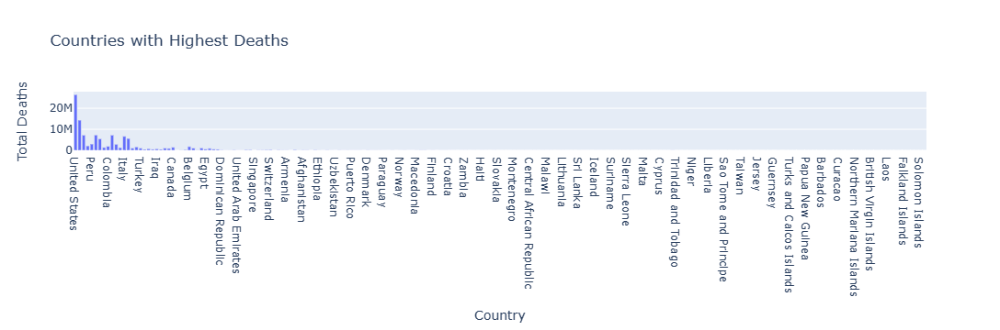

In [ ]:
figure = px.bar(data, y='Total Deaths', x='Country',
            title="Countries with Highest Deaths")
pyg.walk(figure.show())

Let's compare the total number of cases and deaths in all of these countries. As we can see, the USA has the highest number of Covid-19 cases and deaths, followed by Brazil and India in the second and third positions. It's worth noting that India, Russia, and South Africa have a comparatively lower death rate based on the total number of cases.

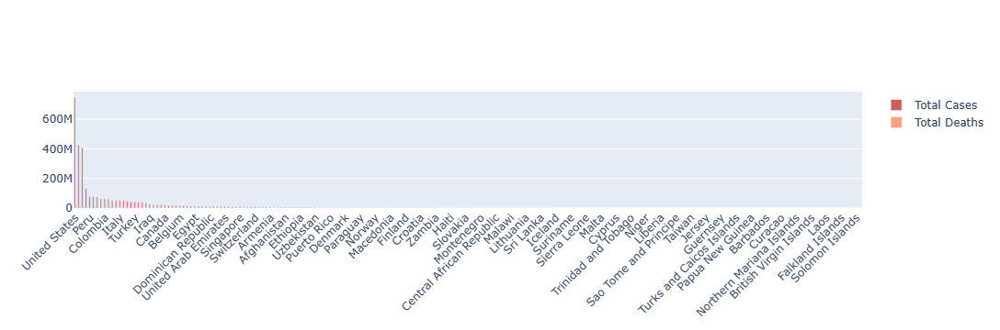

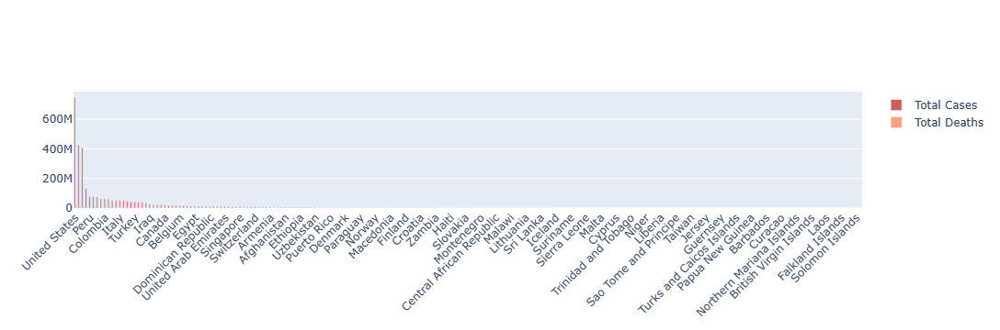

In [ ]:
fig = go.Figure()
fig.add_trace(go.Bar(
    x=data["Country"],
    y=data["Total Cases"],
    name='Total Cases',
    marker_color='indianred'
))
fig.add_trace(go.Bar(
    x=data["Country"],
    y=data["Total Deaths"],
    name='Total Deaths',
    marker_color='lightsalmon'
))
fig.update_layout(barmode='group', xaxis_tickangle=-45)
fig.show()
pyg.walk(fig.show())

Let us now examine the proportion of the total number of cases and total deaths in relation to all the countries with the highest number of Covid-19 cases.

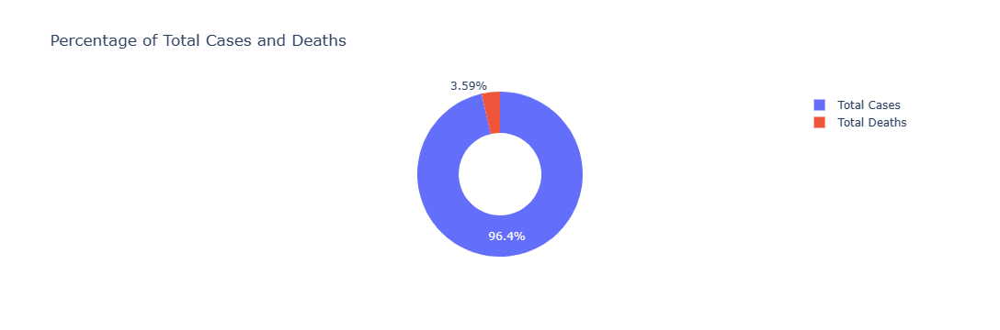

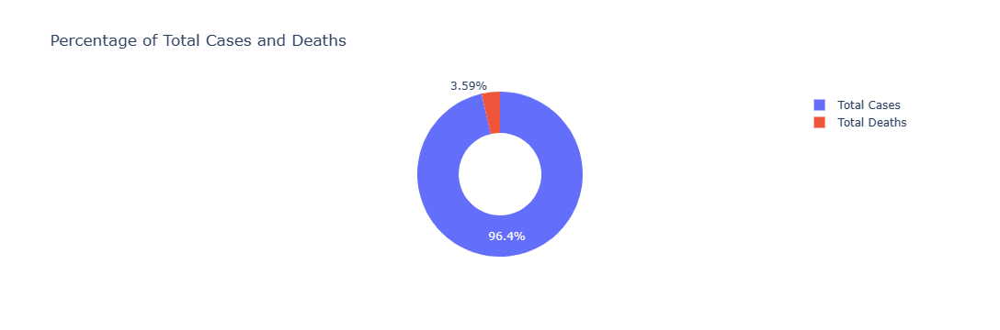

In [ ]:
# Percentage of Total Cases and Deaths
cases = data["Total Cases"].sum()
deceased = data["Total Deaths"].sum()

labels = ["Total Cases", "Total Deaths"]
values = [cases, deceased]

fig = px.pie(data, values=values, names=labels, 
             title='Percentage of Total Cases and Deaths', hole=0.5)
fig.show()
pyg.walk(fig.show())

In [ ]:
# Below is how you can calculate the death rate of Covid-19 cases:
death_rate = (data["Total Deaths"].sum() / data["Total Cases"].sum()) * 100
print("Death Rate = ", death_rate)

Death Rate =  3.6144212045653767


The stringency index is a significant column in this dataset, as it reflects the measures taken by countries to control the spread of covid-19. It is a combined measure of response indicators, such as school and workplace closures, and travel bans.

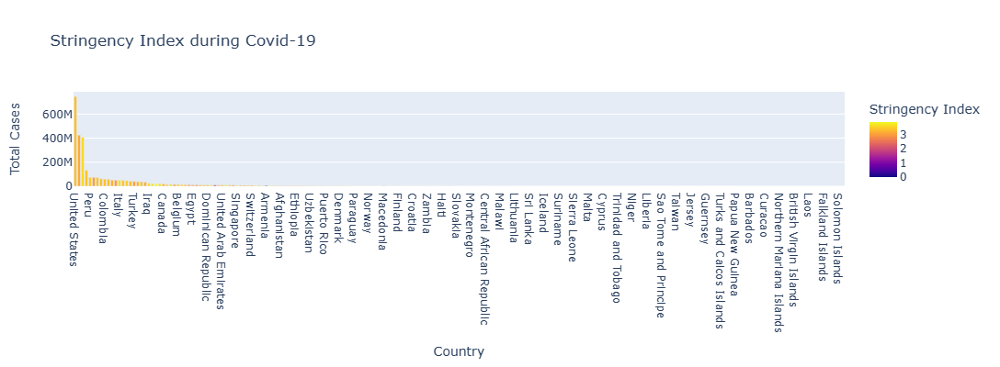

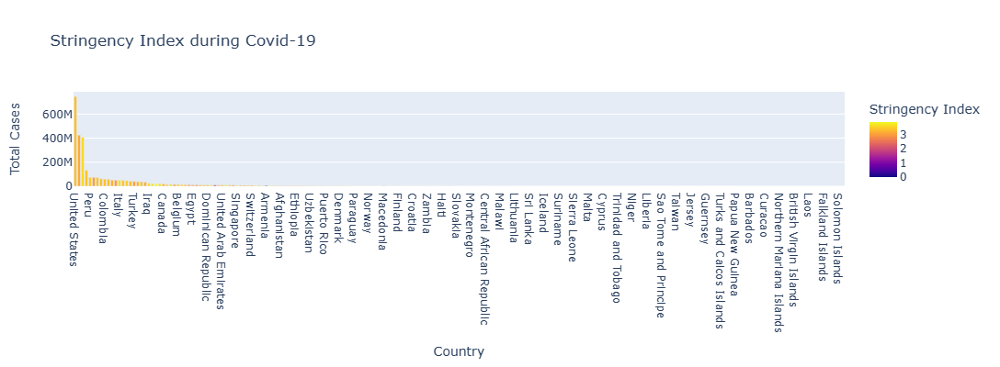

In [ ]:
fig = px.bar(data, x='Country', y='Total Cases',
             hover_data=['Population', 'Total Deaths'], 
             color='Stringency Index', height=400, 
             title= "Stringency Index during Covid-19")
fig.show()
pyg.walk(fig.show())

Above we can see that India is performing well in the stringency index during the outbreak of covid-19.

Analyzing Covid-19 Impacts on Economy
Now let’s move to analyze the impacts of covid-19 on the economy. Here the GDP per capita is the primary factor for analyzing the economic slowdowns caused due to the outbreak of covid-19. Let’s have a look at the GDP per capita before the outbreak of covid-19 among the countries with the highest number of covid-19 cases:

In [ ]:
fig = px.bar(data, x='Country', y='Total Cases',
             hover_data=['Population', 'Total Deaths'], 
             color='GDP Before Covid', height=400, 
             title="GDP Per Capita Before Covid-19")
fig.show()


ValueError: Value of 'color' is not the name of a column in 'data_frame'. Expected one of ['Country Code', 'Country', 'HDI', 'Total Cases', 'Total Deaths', 'Stringency Index', 'Population'] but received: GDP Before Covid

Now let’s have a look at the GDP per capita during the rise in the cases of covid-19:

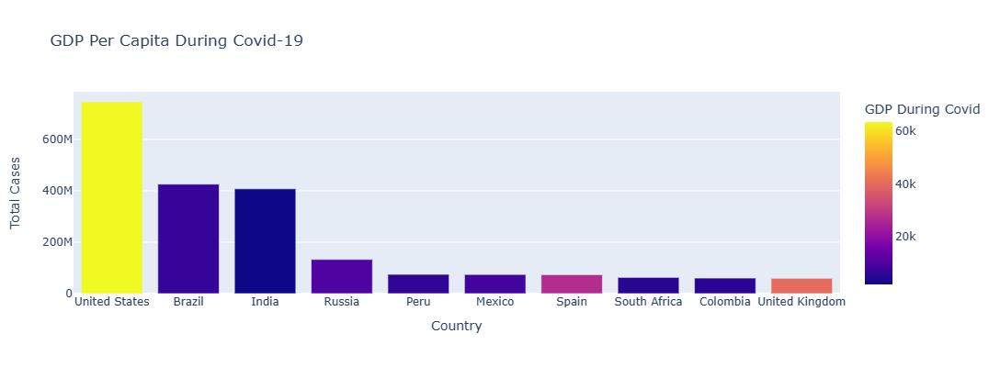

In [ ]:
fig = px.bar(data, x='Country', y='Total Cases',
             hover_data=['Population', 'Total Deaths'], 
             color='GDP During Covid', height=400, 
             title="GDP Per Capita During Covid-19")
fig.show()

Next, we will compare the GDP per capita before and during the covid-19 outbreak to evaluate the impact of the pandemic on GDP per capita.

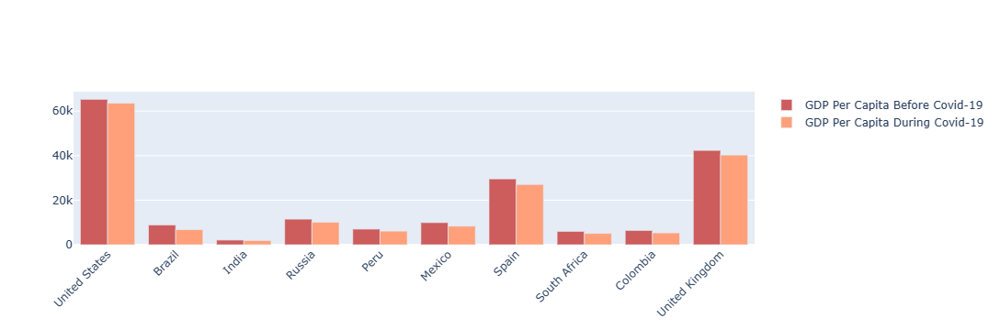

In [ ]:
fig = go.Figure()
fig.add_trace(go.Bar(
    x=data["Country"],
    y=data["GDP Before Covid"],
    name='GDP Per Capita Before Covid-19',
    marker_color='indianred'
))
fig.add_trace(go.Bar(
    x=data["Country"],
    y=data["GDP During Covid"],
    name='GDP Per Capita During Covid-19',
    marker_color='lightsalmon'
))
fig.update_layout(barmode='group', xaxis_tickangle=-45)
fig.show()

The countries with the highest number of covid-19 cases have experienced a decline in GDP per capita, as observed in the previous comparison. Another essential economic factor is the Human Development Index, which is a composite statistic of life expectancy, education, and per capita indicators. Let's examine how many countries have allocated their budget to human development:

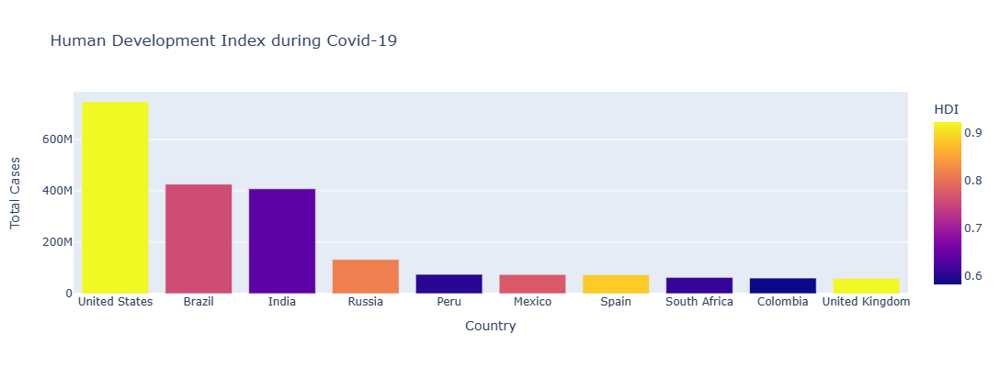

In [ ]:
fig = px.bar(data, x='Country', y='Total Cases',
             hover_data=['Population', 'Total Deaths'], 
             color='HDI', height=400, 
             title="Human Development Index during Covid-19")
fig.show()

In this analysis, I explored the impact of Covid-19 on the global economy and analyzed the spread of the virus across various countries. I observed that the United States had the highest number of Covid-19 cases and deaths, with the country's low stringency index being a contributing factor. Additionally, I analyzed the effect of Covid-19 on GDP per capita in the countries with the highest number of cases, and observed a decline in GDP per capita. Finally, I looked at the budget allocation for human development in various countries. I hope this analysis was insightful, and welcome any questions or feedback in the comments section below.